In [74]:
import os
import pandas as pd
import numpy as np
#import anndata
import time
import matplotlib.pyplot as plt
import json
import requests
import pickle
import gzip as gz

import sys
sys.path.insert(1, '/home/jw3514/Work/CellType_Psy/src/')
from CellType_PSY import *
os.chdir("/home/jw3514/Work/CellType_Psy/AllenBrainCellAtlas/")
print(f"Current working directory: {os.getcwd()}")

Current working directory: /home/jw3514/Work/CellType_Psy/AllenBrainCellAtlas


#  Figure 5 (Cell type results)

In [75]:
def FixSubiculum(DF):
    X = DF.loc["Subiculum_dorsal_part"]
    Y = DF.loc["Subiculum_ventral_part"]
    Z = [(X[0]+Y[0])/2, "Hippocampus", 214]
    DF.loc["Subiculum"] = Z
    DF = DF.drop(["Subiculum_dorsal_part", "Subiculum_ventral_part"])
    return DF

In [76]:
ASD_STR_Bias = pd.read_csv("../../ASD_Circuits/dat/Unionize_bias/Spark_Meta_EWS.Z2.bias.csv", index_col=0)
ASD_STR_Bias = FixSubiculum(ASD_STR_Bias)
ASD_CircuitsSet = pd.read_csv(
    "/home/jw3514/Work/ASD_Circuits/notebooks/ASD.SA.Circuits.Size46.csv",
    index_col="idx")
ASD_Circuits = ASD_CircuitsSet.loc[3, "STRs"].split(";")
ASD_Circuits.append("Subiculum")

## 5A STR Correlation

In [49]:
ASD_STR_Bias = pd.read_csv("../../ASD_Circuits/dat/Unionize_bias/Spark_Meta_EWS.Z2.bias.csv", index_col=0)
ASD_STR_Bias = FixSubiculum(ASD_STR_Bias)
#SC_Agg_Bias = pd.read_csv("dat/JonDat/MERFISH_Bias_NeuroOnly_JC.csv", index_col=0)
SC_Agg_Bias = pd.read_csv("dat/Bias/STR/ASD.MERFISH_Allen.NM.ISHMatch.Z2.csv", index_col=0)

In [50]:
#SC_Agg_Bias = SC_Agg_Bias.rename(columns={"RANK":"Rank"})

In [117]:
ASD_STR_Bias['REGION'] = ASD_STR_Bias['REGION'].replace('Amygdalar', 'Amygdala')

In [118]:
ASD_CircuitsSet = pd.read_csv(
    "/home/jw3514/Work/ASD_Circuits/notebooks/ASD.SA.Circuits.Size46.csv",
    index_col="idx")
ASD_Circuits = ASD_CircuitsSet.loc[3, "STRs"].split(";")
ASD_Circuits.append("Subiculum")

In [119]:
for i,row in ASD_STR_Bias.iterrows():
    ASD_STR_Bias.loc[i, "SC_Bias"] = SC_Agg_Bias.loc[i, "EFFECT"]
    ASD_STR_Bias.loc[i, "SC_Rank"] = int(SC_Agg_Bias.loc[i, "Rank"])
    if i in ASD_Circuits:
        ASD_STR_Bias.loc[i, "isCir"] = 1
    else:
        ASD_STR_Bias.loc[i, "isCir"] = 0

NameError: name 'SC_Agg_Bias' is not defined

In [292]:
def TestBiasCompare(Bias1, Bias2, name1="1", name2="2"):
    REGIONS = list(set(Bias1["REGION"].values))

    REGIONS_seq = ['Isocortex','Olfactory_areas', 'Cortical_subplate', 
                   'Hippocampus','Amygdala','Striatum', 
                   "Thalamus", "Hypothalamus", "Midbrain", 
                   "Medulla", "Pallidum", "Pons", 
                   "Cerebellum"]
    REG_COR_Dic = dict(zip(REGIONS_seq, ["#268ad5", "#D5DBDB", "#7ac3fa", 
                                     "#2c9d39", "#742eb5", "#ed8921", 
                                     "#e82315", "#E6B0AA", "#f6b26b",  
                                     "#20124d", "#2ECC71", "#D2B4DE", 
                                     "#ffd966", ]))
    plt.figure(dpi=300, figsize=(6, 4))

    # Use Seaborn for style and color palette
    sns.set(style="whitegrid", context="talk")
    palette = sns.color_palette("deep")

    JoinDF = Bias1.join(Bias2, how="inner", lsuffix="_{}".format(name1), rsuffix="_{}".format(name2))
    R,P = pearsonr(JoinDF["EFFECT_{}".format(name1)].values, JoinDF["EFFECT_{}".format(name2)].values)
    RR,PP = spearmanr(JoinDF["EFFECT_{}".format(name1)].values, JoinDF["EFFECT_{}".format(name2)].values)
    # Scatter plot with improved aesthetics
    for reg in REGIONS_seq:
        RegDF = JoinDF[JoinDF["REGION_{}".format(name1)]==reg]
        X = RegDF["EFFECT_{}".format(name1)].values
        Y = RegDF["EFFECT_{}".format(name2)].values
        plt.scatter(X, Y, facecolor=REG_COR_Dic[reg], alpha=0.7, s=20, label=reg.replace("_", " "))
    minX, maxY = min(JoinDF["EFFECT_{}".format(name1)].values), max(JoinDF["EFFECT_{}".format(name2)].values)
    
    Top50_X = JoinDF.sort_values("EFFECT_{}".format(name1), ascending=False).head(50).index.values
    top50_Y = JoinDF.sort_values("EFFECT_{}".format(name2), ascending=False).head(50).index.values 
    STR_Com = len(set(Top50_X).intersection(set(top50_Y)))
    #plt.text(x=minX, y=maxY*0.7, s="r=%.2f P<%.1e\nrho=%.2f P<%.1e\nSTR_Comm=%d"%(R, P, RR, PP, STR_Com), 
    #         fontsize=6, weight='bold')
    #plt.text(x=minX, y=maxY*0.7, s="r=%.2f\nP<%.1e\nrho=%.2f P<%.1e"%(R, np.max([P, 1e-10]), RR, 
    #                                                                 np.max([PP, 1e-10])), 
    #         fontsize=6, weight='bold')
    plt.text(x=minX-0.2, y=maxY*0.7, s="r=%.2f\nP<%.1e"%(R, np.max([P, 1e-10])), 
             fontsize=12, weight='bold')
    # Adding labels, title, and legend
    plt.xlabel(name1, fontsize=14, weight='bold')
    plt.ylabel(name2, fontsize=14, weight='bold')
    #plt.title("Scatter Plot of EFFECT vs. SC_Bias", fontsize=16, weight='bold')
    #plt.legend(fontsize=6)
    plt.legend(fontsize=8, bbox_to_anchor=(1.05, 1), loc='upper left', borderaxespad=0.)
    plt.plot([-1.1, 0.8], [-1.1, 0.8], color="grey", alpha=0.3)
    plt.xlim(-1.1, 0.8)
    plt.ylim(-1.1, 0.8)
    # Adding grid lines
    plt.grid(True, linestyle='--', alpha=0.5)

    # Adjusting ticks
    plt.xticks(fontsize=12)
    plt.yticks(fontsize=12)

    # Display the plot
    plt.tight_layout()
    plt.show()

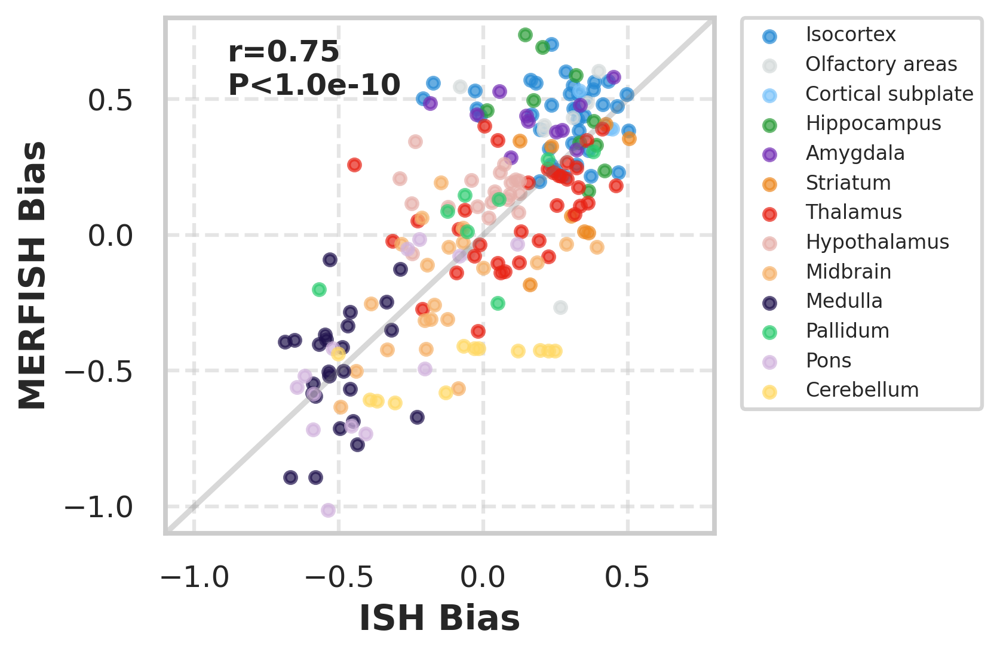

In [293]:
Bias1 = ASD_STR_Bias
Bias2 = SC_Agg_Bias
#BiasCorrelation(Bias1, Bias2, "Z2", "Zmatch")
TestBiasCompare(Bias1, Bias2,  "ISH Bias", "MERFISH Bias")

In [212]:
REGIONS_seq = ['Isocortex','Olfactory_areas', 'Cortical_subplate', 
               'Hippocampus','Amygdala','Striatum', 
               "Thalamus", "Hypothalamus", "Midbrain", 
               "Medulla", "Pallidum", "Pons", 
               "Cerebellum"]
REG_COR_Dic = dict(zip(REGIONS_seq, ["#268ad5", "#D5DBDB", "#7ac3fa", 
                                 "#2c9d39", "#742eb5", "#ed8921", 
                                 "#e82315", "#E6B0AA", "#f6b26b",  
                                 "#20124d", "#2ECC71", "#D2B4DE", 
                                 "#ffd966", ]))

In [213]:
ISH_REG_Bias = []
MF_REG_Bias = []
for Reg in REGIONS_seq:
    ISH_Reg = ASD_STR_Bias[ASD_STR_Bias["REGION"]==Reg]["EFFECT"]
    MF_Reg = SC_Agg_Bias[SC_Agg_Bias["REGION"]==Reg]["EFFECT"]
    #print(Reg, ISH_Reg.max() - ISH_Reg.min(), MF_Reg.max() - MF_Reg.min())
    #ISH_REG_Bias.append(ISH_Reg.mean())
    #MF_REG_Bias.append(MF_Reg.mean())
    ISH_REG_Bias.append(np.nanmean(ISH_Reg))
    MF_REG_Bias.append(np.nanmean(MF_Reg))
    print(Reg, np.nanmean(ISH_Reg), np.nanmean(MF_Reg))

Isocortex 0.2646433690554956 0.43796197651758256
Olfactory_areas 0.20298273642666098 0.3163420337357183
Cortical_subplate 0.40465333609341547 0.43783937556782454
Hippocampus 0.2749247026897721 0.44672436441858254
Amygdala 0.17093540833298707 0.4314424409463756
Striatum 0.30889818448758644 0.16832013210671143
Thalamus 0.12254585054153484 0.08695363494907073
Hypothalamus -0.0093253449517182 0.15525093419963135
Midbrain -0.1358086974356606 -0.2008053643266929
Medulla -0.5010100064454449 -0.4891183377514492
Pallidum -0.01316631741493747 0.06426964122588553
Pons -0.3852995482182111 -0.45505148580622035
Cerebellum -0.08508656434954343 -0.483421168780417


0.8926930405037162 4.026173009707292e-05 0.8901098901098902 4.565437440744702e-05


Text(0, 0.5, 'MERFISH per Vol')

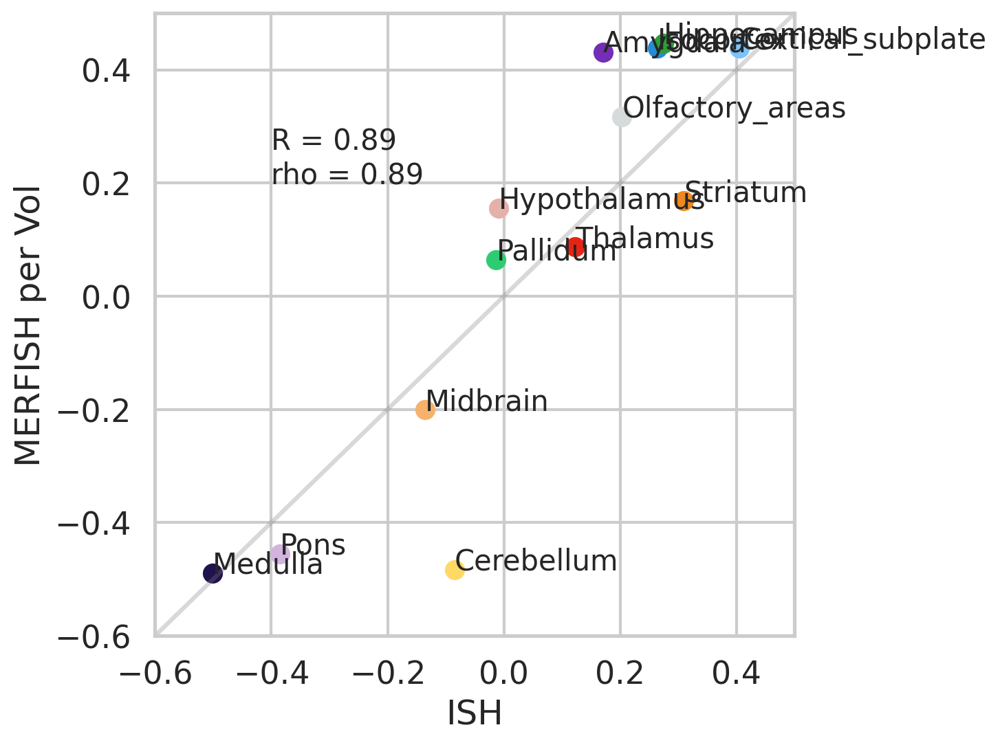

In [216]:
R1, P1 = pearsonr(ISH_REG_Bias, MF_REG_Bias)
R2, P2 = spearmanr(ISH_REG_Bias, MF_REG_Bias)
print(R1, P1, R2, P2)
plt.figure(dpi=200, figsize=(6,6))
for Reg in REGIONS_seq:
    ISH_Reg = ASD_STR_Bias[ASD_STR_Bias["REGION"]==Reg]["EFFECT"]
    MF_Reg = SC_Agg_Bias[SC_Agg_Bias["REGION"]==Reg]["EFFECT"]
    X = ISH_Reg.mean()
    Y = MF_Reg.mean()
    plt.scatter(ISH_Reg.mean(), MF_Reg.mean(), color=REG_COR_Dic[Reg])
    plt.text(X, Y, s=Reg, fontsize=15)
plt.plot([-0.6, 0.5], [-0.6, 0.5], color="grey", alpha=0.3)
plt.text(-0.4, 0.2, s="R = %.2f\nrho = %.2f"%(R1, R2), fontsize=15)
plt.xlabel("ISH")
plt.xlim(-0.6, 0.5)
plt.ylim(-0.6, 0.5)
plt.ylabel("MERFISH per Vol")

## 5B Sub Types

In [80]:
#ASD_Cluster_Bias_for_DN = pd.read_csv("dat/Bias/ASD.ClusterV3.top60.UMI.Z2.pvalues.csv", index_col=0)
#ASD_Cluster_Bias_noDN = pd.read_csv("dat/Bias/ASD.ClusterV3.top60.UMI.Z2.noDN.pvalues.csv", index_col=0)
ASD_BiasDN_z1clip3_addP = pd.read_csv("dat/Bias/ASD.ClusterV3.top60.UMI.Z2.z1clip3.addP.csv", index_col=0)
#ASD_Bias.to_csv("dat/Bias/ASD.ClusterV3.top60.UMI.Z2.pvalues.csv")

### V1 QQ Plot

In [81]:
def GetExpQ(pvalues):
    sorted_pvalues = np.sort(pvalues)
    expected = np.linspace(0, 1, len(sorted_pvalues), endpoint=False)[1:]
    expected_quantiles = -np.log10(expected)
    observed_quantiles = -np.log10(sorted_pvalues[1:])
    return expected_quantiles, observed_quantiles

In [227]:
def QQPlot_MouseSC(DF_w_Pvalues, Classes, max_val=4.1):
    P_Q005_DF = DF_w_Pvalues[DF_w_Pvalues["qvalues"]<0.05]#
    if P_Q005_DF.shape[0] > 0:
        P_Q005 = P_Q005_DF["Pvalue"][-1]
    else:
        P_Q005 = -1
    P_Q01_DF = DF_w_Pvalues[DF_w_Pvalues["qvalues"]<0.1]#["Pvalue"][-1]
    if P_Q01_DF.shape[0] > 0:
        P_Q01 = P_Q01_DF["Pvalue"][-1]
    else:
        P_Q01 = -1

    plt.figure(dpi=300, figsize=(10, 8))
    sns.set(style="whitegrid", context="talk")

    # Plot the quantiles
    for Class in Classes:
        tmp = DF_w_Pvalues[DF_w_Pvalues["class_id_label"]==Class]
        Class_Pvals = tmp["Pvalue"].values
        Qexp, Qobs = GetExpQ(Class_Pvals)
        plt.scatter(Qexp, Qobs , alpha=0.7, s=50, label=Class)

    Other = DF_w_Pvalues[~DF_w_Pvalues["class_id_label"].isin(Classes)]
    Other_Pvals = Other["Pvalue"].values
    Qexp, Qobs = GetExpQ(Other_Pvals)
    plt.scatter(Qexp, Qobs , alpha=0.7, color="grey", s=50, label="Other")

    if P_Q005 != -1:
        plt.axhline(y=-np.log10(P_Q005), color='grey', linestyle='--', linewidth=2,)
        plt.text(x=3.25, y=-np.log10(P_Q005) + 0.05, s="FDR 0.05")
    if P_Q01 != -1:
        plt.axhline(y=-np.log10(P_Q01), color='grey', linestyle='--', linewidth=2,)
        plt.text(x=3.25, y=-np.log10(P_Q01) + 0.05, s="FDR 0.1")

    # Add a reference line
    plt.plot([0, max_val], [0, max_val], 'r--', linewidth=2)

    # Add labels and title
    plt.xlabel('Expected -log10(p-value)', fontsize=25, weight='bold')
    plt.ylabel('Observed -log10(p-value)', fontsize=25, weight='bold')
    #plt.title(title, fontsize=16, weight='bold')

    # Customize the ticks
    plt.xticks(fontsize=20)
    plt.yticks(fontsize=20)

    # Add grid
    plt.grid(True, linestyle='--', alpha=0.5)

    # Tight layout
    plt.tight_layout()
    plt.legend(fontsize=15, loc="lower right")

    # Show the plot
    plt.show()

In [228]:
Classes = ["01 IT-ET Glut",  "02 NP-CT-L6b Glut", 
           "09 CNU-LGE GABA", "18 TH Glut", "11 CNU-HYa GABA", "13 CNU-HYa Glut"]

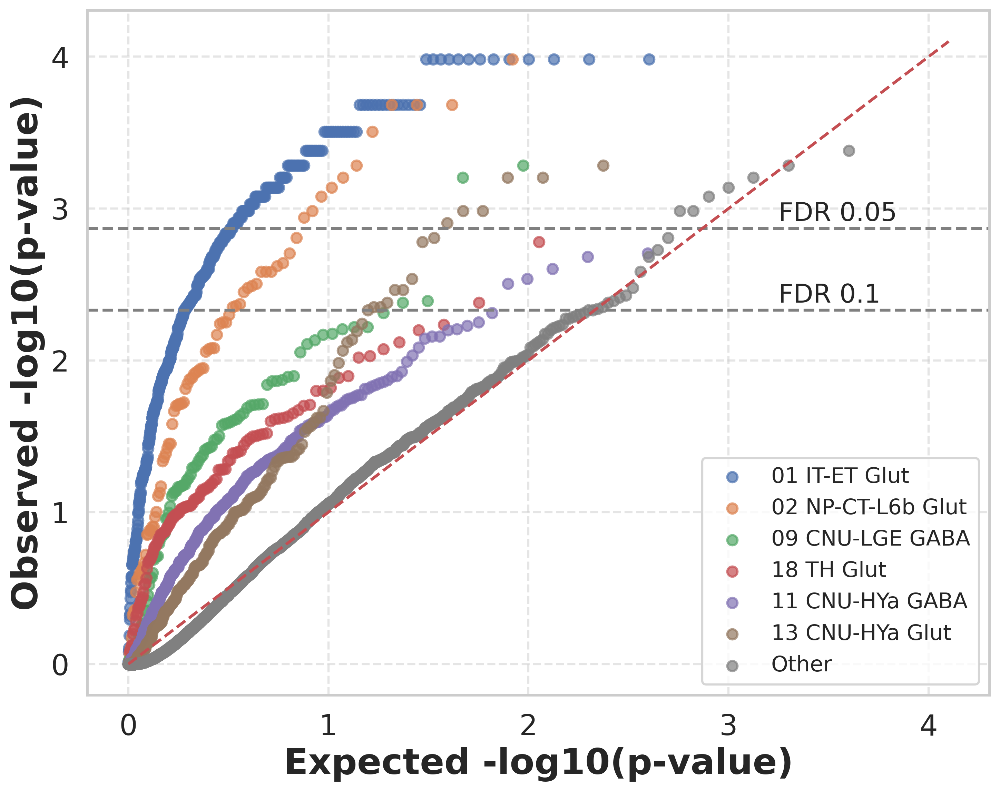

In [229]:
QQPlot_MouseSC(ASD_BiasDN_z1clip3_addP, Classes)

## V2 Boxplot

In [91]:
CellTypesDF = pd.read_csv("dat/CellTypeHierarchy.csv")
Class2Cluster = {}
Subclass2Cluster = {}
for i, row in CellTypesDF.iterrows():
    _cluster, _class, _subclass, _supertype = row
    if _class not in Class2Cluster:
        Class2Cluster[_class] = []
    if _subclass not in Subclass2Cluster:
        Subclass2Cluster[_subclass] = []
    Class2Cluster[_class].append(_cluster)
    Subclass2Cluster[_subclass].append(_cluster)

In [92]:
def ClassBiasBoxPlot(DF):
    Class = sorted(Class2Cluster.keys())
    sns.set(style="whitegrid", context="talk")
    # Calculate medians and sort data by medians
    ASD_dat_CB = []
    medians = []
    for _CT in Class:
        subdf = DF[DF["class_id_label"]==_CT]
        data = [x for x in subdf["EFFECT"].values if x==x]
        ASD_dat_CB.append(data)
        medians.append(np.median(data))

    # Sort based on medians
    sorted_indices = np.argsort(medians)
    sorted_ASD_dat_CB = [ASD_dat_CB[i] for i in sorted_indices]
    sorted_Class = [Class[i] for i in sorted_indices]

    # Plotting
    fig, ax = plt.subplots(dpi=480, figsize=(8, 8))
    boxplot = ax.boxplot(sorted_ASD_dat_CB, labels=sorted_Class, vert=False, patch_artist=True)
    colors = sns.color_palette("muted", len(sorted_Class))
    for patch, color in zip(boxplot['boxes'], colors):
        patch.set_facecolor(color)

    plt.grid(True, linestyle='--', alpha=0.7)
    plt.xlabel('ASD Bias', fontsize=14)
    plt.ylabel('Classes', fontsize=14)
    plt.title('ASD Bias Across Different Classes', fontsize=16, weight='bold')
    ax.grid(True, linestyle='--', alpha=0.7)

    plt.xticks(fontsize=12)
    plt.yticks(fontsize=12)

    plt.tight_layout()
    plt.show()

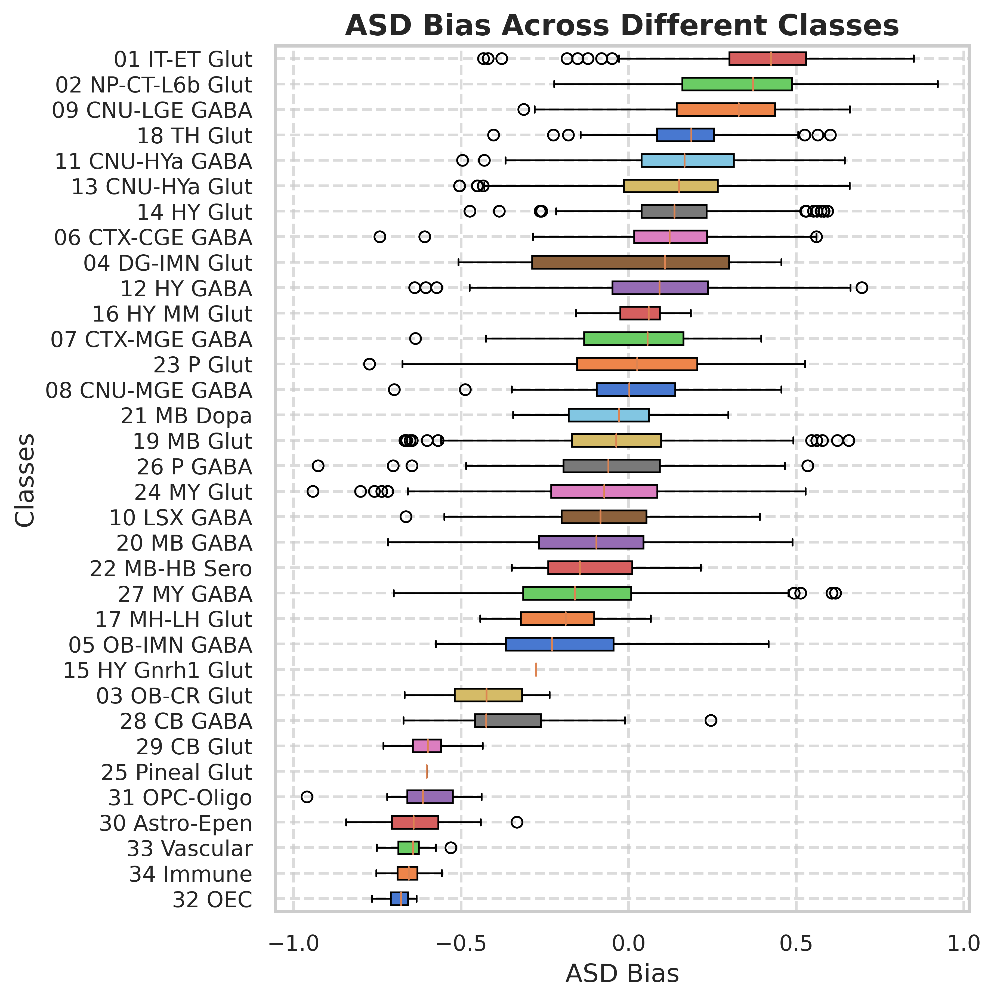

In [93]:
ClassBiasBoxPlot(ASD_BiasDN_z1clip3_addP)

# C - Subclass level for selected classes

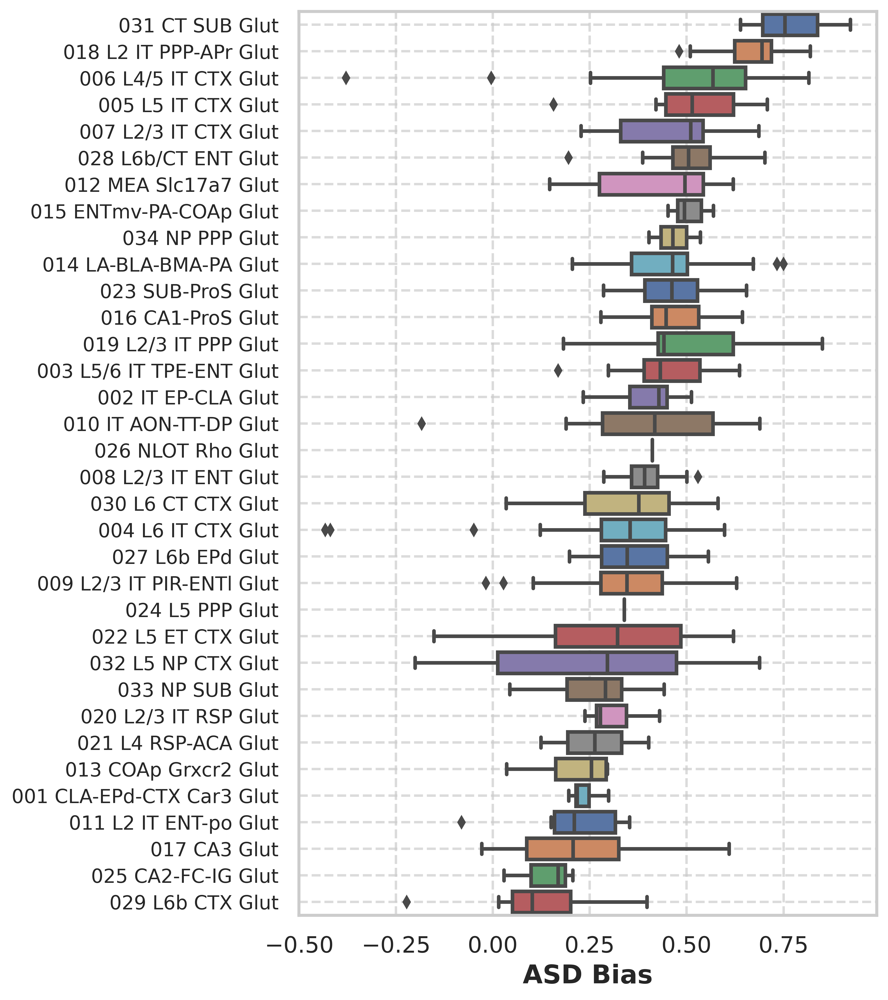

In [94]:
# Sample data generation (using the provided example structure)
Subclass = sorted(Subclass2Cluster.keys())
CNU_HYa_Glut = Subclass[0:34] # CTX Glut
dat = []
for _CT in CNU_HYa_Glut:
    clusters_ = Subclass2Cluster[_CT]
    clusters_ = [x for x in clusters_ if x in ASD_BiasDN_z1clip3_addP.index.values]
    dat.append([x for x in ASD_BiasDN_z1clip3_addP.loc[clusters_, "EFFECT"].values if x==x])

# Calculate medians and sort data based on medians
medians = [np.median(d) for d in dat]
sorted_indices = np.argsort(medians)[::-1]
sorted_dat = [dat[i] for i in sorted_indices]
sorted_CNU_HYa_Glut = [CNU_HYa_Glut[i] for i in sorted_indices]

# Set up the plotting style and context
sns.set(style="whitegrid", context="talk")

# Create the plot
fig, ax = plt.subplots(dpi=480, figsize=(8, 9))  # Adjust the figure size as needed

# Create the boxplot
sns.boxplot(data=sorted_dat, orient='h', ax=ax, palette='deep')

# Set the labels
ax.set_xlabel("ASD Bias", fontsize=16, weight='bold')
ax.set_yticklabels(sorted_CNU_HYa_Glut, fontsize=12)

# Improve grid and layout
ax.grid(True, linestyle='--', alpha=0.7)
plt.tight_layout()

# Customize the ticks
plt.xticks(fontsize=14)
plt.yticks(fontsize=12)

# Add title if necessary
# plt.title("ASD Bias Across Different Subclasses", fontsize=18, weight='bold')

# Display the plot
plt.show()

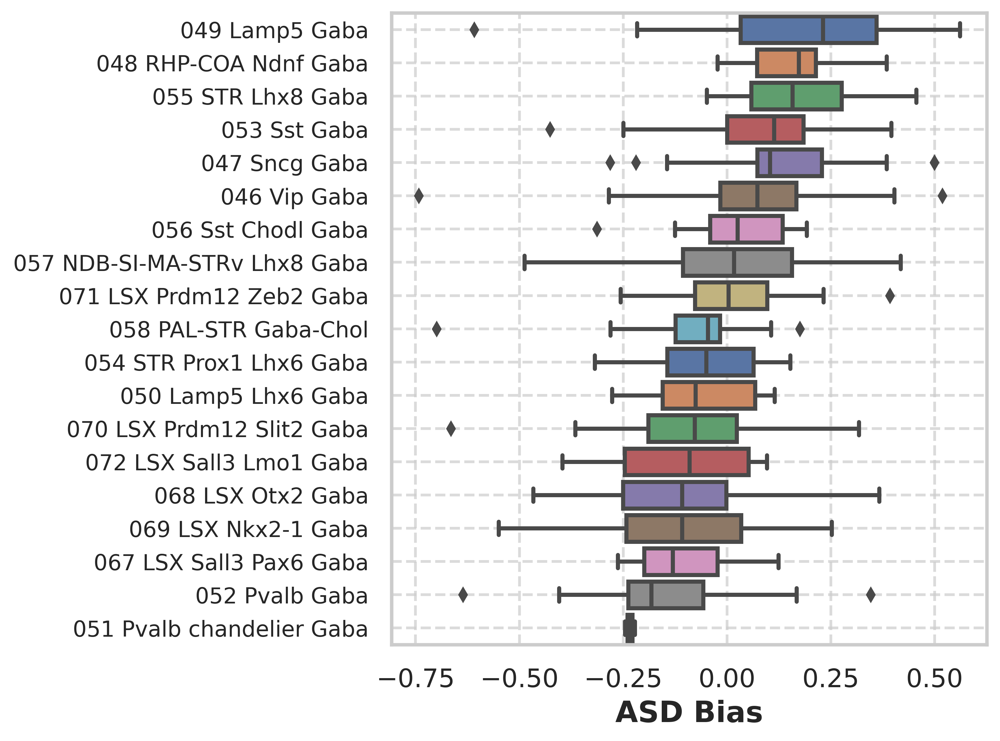

In [96]:
# Sample data generation (using the provided example structure)
Subclass = sorted(Subclass2Cluster.keys())
CNU_HYa_Glut = Subclass[45:58]+Subclass[66:72] # CTX GABA
dat = []
for _CT in CNU_HYa_Glut:
    dat.append([x for x in ASD_BiasDN_z1clip3_addP.loc[Subclass2Cluster[_CT], "EFFECT"].values if x==x])

# Calculate medians and sort data based on medians
medians = [np.median(d) for d in dat]
sorted_indices = np.argsort(medians)[::-1]
sorted_dat = [dat[i] for i in sorted_indices]
sorted_CNU_HYa_Glut = [CNU_HYa_Glut[i] for i in sorted_indices]

# Set up the plotting style and context
sns.set(style="whitegrid", context="talk")

# Create the plot
fig, ax = plt.subplots(dpi=480, figsize=(8, 6))  # Adjust the figure size as needed

# Create the boxplot
sns.boxplot(data=sorted_dat, orient='h', ax=ax, palette='deep')

# Set the labels
ax.set_xlabel("ASD Bias", fontsize=16, weight='bold')
ax.set_yticklabels(sorted_CNU_HYa_Glut, fontsize=12)

# Improve grid and layout
ax.grid(True, linestyle='--', alpha=0.7)
plt.tight_layout()

# Customize the ticks
plt.xticks(fontsize=14)
plt.yticks(fontsize=12)

# Add title if necessary
# plt.title("ASD Bias Across Different Subclasses", fontsize=18, weight='bold')

# Display the plot
plt.show()

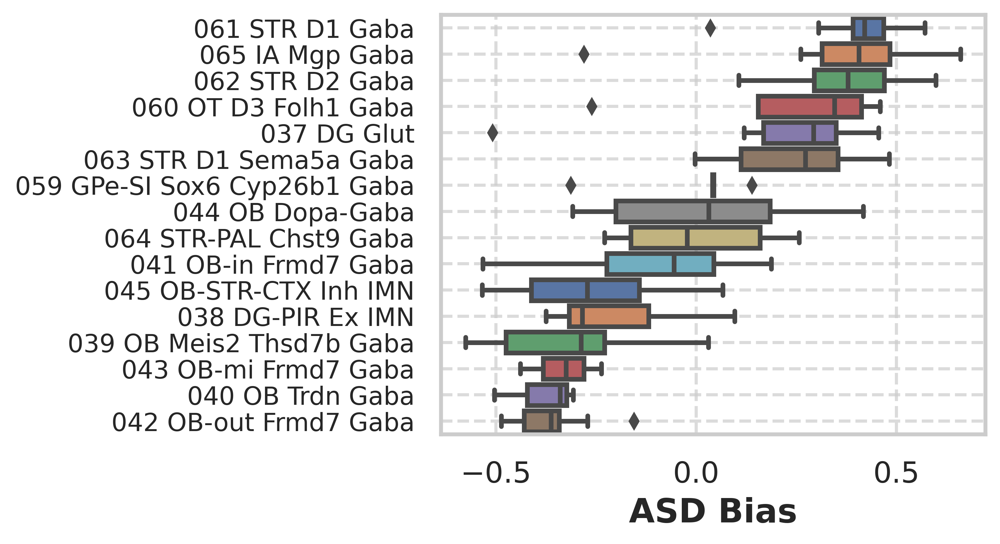

In [97]:
# Sample data generation (using the provided example structure)
Subclass = sorted(Subclass2Cluster.keys())
CNU_HYa_Glut = Subclass[58:65]+Subclass[36:45]
dat = []
for _CT in CNU_HYa_Glut:
    dat.append([x for x in ASD_BiasDN_z1clip3_addP.loc[Subclass2Cluster[_CT], "EFFECT"].values if x==x])

# Calculate medians and sort data based on medians
medians = [np.median(d) for d in dat]
sorted_indices = np.argsort(medians)[::-1]
sorted_dat = [dat[i] for i in sorted_indices]
sorted_CNU_HYa_Glut = [CNU_HYa_Glut[i] for i in sorted_indices]

# Set up the plotting style and context
sns.set(style="whitegrid", context="talk")

# Create the plot
fig, ax = plt.subplots(dpi=480, figsize=(7, 4))  # Adjust the figure size as needed

# Create the boxplot
sns.boxplot(data=sorted_dat, orient='h', ax=ax, palette='deep')

# Set the labels
ax.set_xlabel("ASD Bias", fontsize=16, weight='bold')
ax.set_yticklabels(sorted_CNU_HYa_Glut, fontsize=12)

# Improve grid and layout
ax.grid(True, linestyle='--', alpha=0.7)
plt.tight_layout()

# Customize the ticks
plt.xticks(fontsize=14)
plt.yticks(fontsize=12)

plt.show()

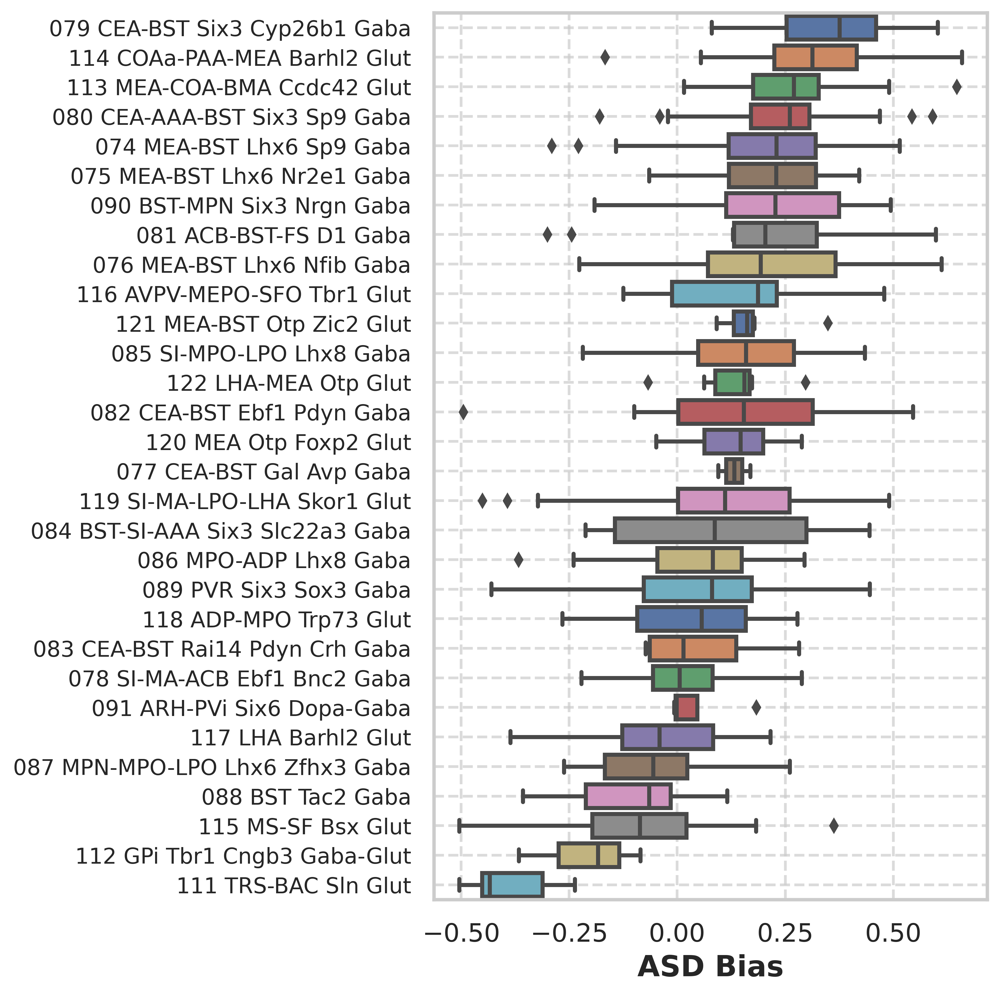

In [98]:
# Sample data generation (using the provided example structure)
Subclass = sorted(Subclass2Cluster.keys())
CNU_HYa_Glut = Subclass[73:91] + Subclass[110:122]
dat = []
for _CT in CNU_HYa_Glut:
    dat.append([x for x in ASD_BiasDN_z1clip3_addP.loc[Subclass2Cluster[_CT], "EFFECT"].values if x==x])

# Calculate medians and sort data based on medians
medians = [np.median(d) for d in dat]
sorted_indices = np.argsort(medians)[::-1]
sorted_dat = [dat[i] for i in sorted_indices]
sorted_CNU_HYa_Glut = [CNU_HYa_Glut[i] for i in sorted_indices]

# Set up the plotting style and context
sns.set(style="whitegrid", context="talk")

# Create the plot
fig, ax = plt.subplots(dpi=480, figsize=(8, 8))  # Adjust the figure size as needed

# Create the boxplot
sns.boxplot(data=sorted_dat, orient='h', ax=ax, palette='deep')

# Set the labels
ax.set_xlabel("ASD Bias", fontsize=16, weight='bold')
ax.set_yticklabels(sorted_CNU_HYa_Glut, fontsize=12)

# Improve grid and layout
ax.grid(True, linestyle='--', alpha=0.7)
plt.tight_layout()

# Customize the ticks
plt.xticks(fontsize=14)
plt.yticks(fontsize=12)

plt.show()

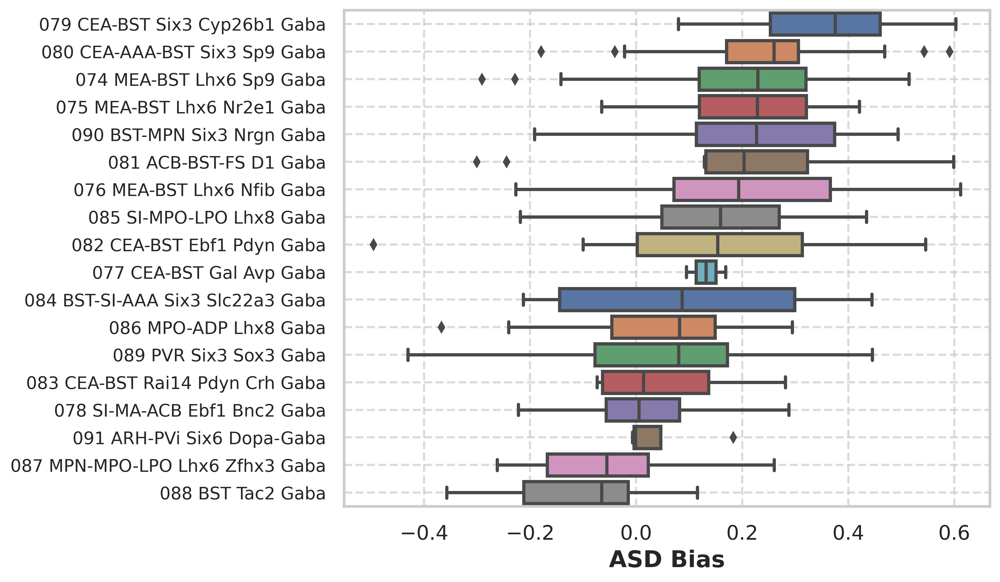

In [100]:
# Sample data generation (using the provided example structure)
Subclass = sorted(Subclass2Cluster.keys())
CNU_HYa_Glut = Subclass[73:91]
dat = []
for _CT in CNU_HYa_Glut:
    dat.append([x for x in ASD_BiasDN_z1clip3_addP.loc[Subclass2Cluster[_CT], "EFFECT"].values if x==x])

# Calculate medians and sort data based on medians
medians = [np.median(d) for d in dat]
sorted_indices = np.argsort(medians)[::-1]
sorted_dat = [dat[i] for i in sorted_indices]
sorted_CNU_HYa_Glut = [CNU_HYa_Glut[i] for i in sorted_indices]

# Set up the plotting style and context
sns.set(style="whitegrid", context="talk")

# Create the plot
fig, ax = plt.subplots(dpi=480, figsize=(10, 6))  # Adjust the figure size as needed

# Create the boxplot
sns.boxplot(data=sorted_dat, orient='h', ax=ax, palette='deep')

# Set the labels
ax.set_xlabel("ASD Bias", fontsize=16, weight='bold')
ax.set_yticklabels(sorted_CNU_HYa_Glut, fontsize=12)

# Improve grid and layout
ax.grid(True, linestyle='--', alpha=0.7)
plt.tight_layout()

# Customize the ticks
plt.xticks(fontsize=14)
plt.yticks(fontsize=12)

plt.show()

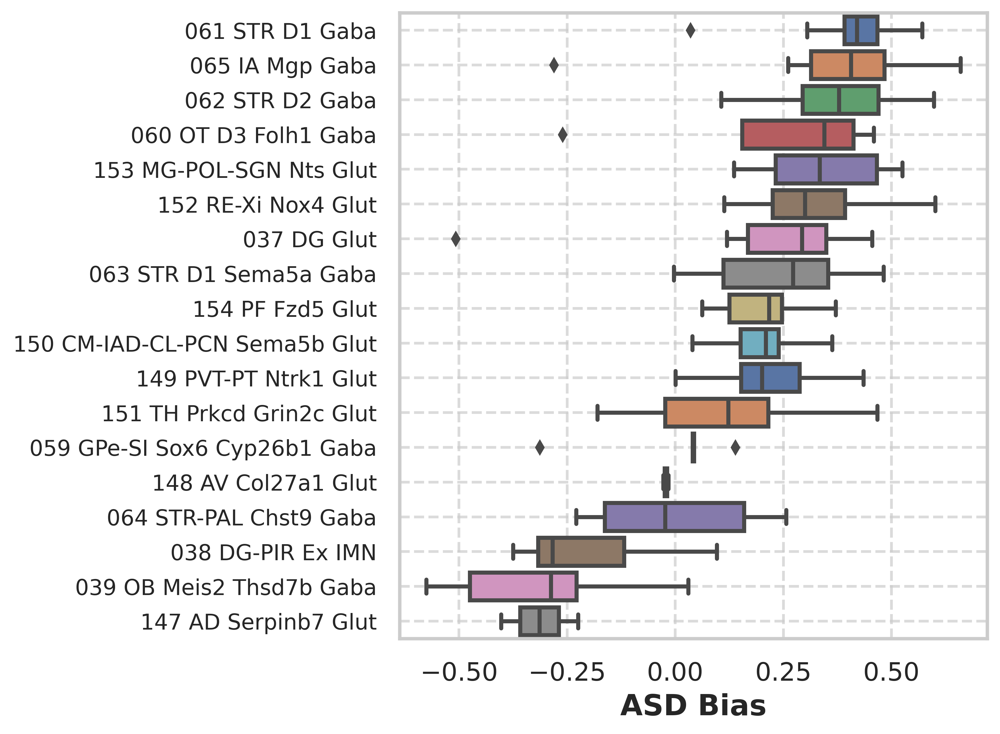

In [101]:
# Sample data generation (using the provided example structure)
Subclass = sorted(Subclass2Cluster.keys())
CNU_HYa_Glut = Subclass[146:154] +  Subclass[58:65] + Subclass[36:39]
dat = []
for _CT in CNU_HYa_Glut:
    dat.append([x for x in ASD_BiasDN_z1clip3_addP.loc[Subclass2Cluster[_CT], "EFFECT"].values if x==x])

# Calculate medians and sort data based on medians
medians = [np.median(d) for d in dat]
sorted_indices = np.argsort(medians)[::-1]
sorted_dat = [dat[i] for i in sorted_indices]
sorted_CNU_HYa_Glut = [CNU_HYa_Glut[i] for i in sorted_indices]

# Set up the plotting style and context
sns.set(style="whitegrid", context="talk")

# Create the plot
fig, ax = plt.subplots(dpi=480, figsize=(8, 6))  # Adjust the figure size as needed

# Create the boxplot
sns.boxplot(data=sorted_dat, orient='h', ax=ax, palette='deep')

# Set the labels
ax.set_xlabel("ASD Bias", fontsize=16, weight='bold')
ax.set_yticklabels(sorted_CNU_HYa_Glut, fontsize=12)

# Improve grid and layout
ax.grid(True, linestyle='--', alpha=0.7)
plt.tight_layout()

# Customize the ticks
plt.xticks(fontsize=14)
plt.yticks(fontsize=12)

plt.show()

# F (STR vs CT Mat)

In [77]:
MERFISH = pd.read_csv("dat/MERFISH/MERFISH.cells.ASD.Bias.Anno.csv", index_col=0)

In [78]:
ASD_Circuits_cleannames = [" ".join(x.split("_")) for x in ASD_Circuits]
#ASD_Circuits_cleannames.append("Subiculum")
ASD_Circuits_cleannames.remove("Subiculum ventral part")
ASD_Circuits_cleannames.remove("Subiculum dorsal part")

In [79]:
MERFISH_Circuit = MERFISH[MERFISH["ISH_STR"].isin(ASD_Circuits_cleannames)]
MERFISH_Circuit.shape

(1165446, 40)

In [80]:
class_counts = MERFISH_Circuit["class"].value_counts()
class_counts = class_counts[class_counts>1000]

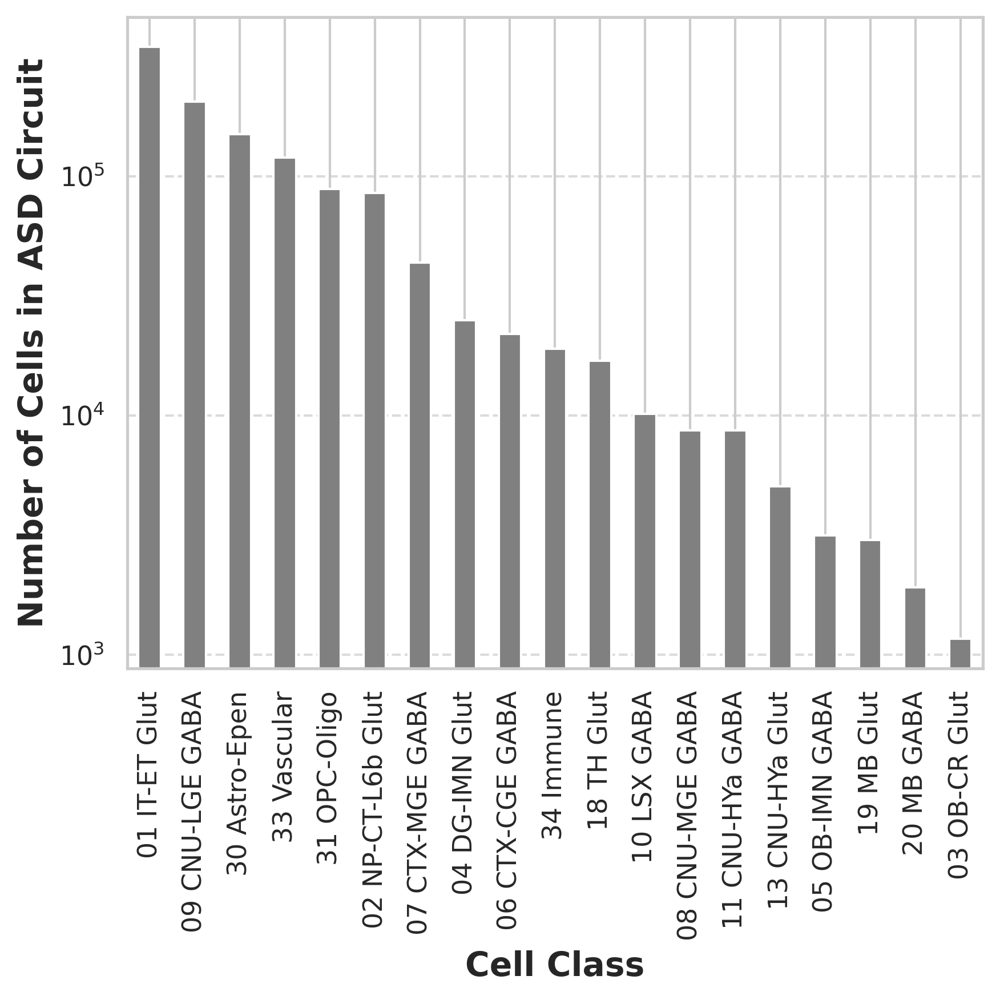

In [81]:
sns.set(style="whitegrid")
plt.figure(dpi=300, figsize=(6, 6))
class_counts.plot(kind='bar', color='grey')

# Adding labels and title
plt.xlabel('Cell Class', fontsize=14, weight='bold')
plt.ylabel('Number of Cells in ASD Circuit', fontsize=14, weight='bold')
#plt.title('Bar Plot from Pandas Series', fontsize=14)
plt.yscale('log')  # Set y-axis to log scale
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Show the plot
plt.tight_layout()
plt.show()

In [82]:
ASD_Cir_Clusters = set(MERFISH_Circuit["cluster"].values)

In [83]:
ASD_Cluster_Bias_for_DN = pd.read_csv("dat/Bias/ASD.ClusterV3.top60.UMI.Z2.z1clip3.addP.csv", index_col=0)

In [84]:
Cir_ASD_Cluster_Bias_for_DN_sub = ASD_Cluster_Bias_for_DN[ASD_Cluster_Bias_for_DN.index.isin(ASD_Cir_Clusters)]

In [85]:
# Annotate ASD Bias
for i, row in MERFISH_Circuit.iterrows():
    cluster = row["cluster"]
    if cluster not in ASD_Cluster_Bias_for_DN.index.values:
        MERFISH_Circuit.loc[i, "ASD.Bias"] = 0
    else:
        MERFISH_Circuit.loc[i, "ASD.Bias"] = ASD_Cluster_Bias_for_DN.loc[cluster, "EFFECT"]
    #MERFISH_Circuit.loc[i, "SCZ.Bias.adj"] = SCZ_Cluster_Bias_for_DN.loc[cluster, "Bias_Adj"]

In [86]:
cluster_counts = MERFISH_Circuit["cluster"].value_counts()
cluster_counts = cluster_counts[cluster_counts>50]

In [87]:
cluster_counts_df = pd.DataFrame(cluster_counts)
cluster_counts_df.columns = ['Count']
cluster_counts_df.index.name = 'Cluster'
cluster_counts_df.to_csv("dat/ASD.Cluster.Count.csv")

In [88]:
cluster_counts.shape

(983,)

In [89]:
subclass_counts = MERFISH_Circuit["subclass"].value_counts()
subclass_counts = subclass_counts[subclass_counts>500]

In [90]:
asd_str_subclass_bias_dat = []
for STR_ in ASD_Circuits_cleannames:
    tmp = MERFISH_Circuit[MERFISH_Circuit["ISH_STR"]==STR_]
    _str_subclass_bias_dat = []
    for subclass,n in subclass_counts.items():
        tmptmp = tmp[tmp["subclass"]==subclass]
        if tmptmp.shape[0] == 0:
            _str_subclass_bias_dat.append(0)
        else:
            _str_subclass_bias_dat.append(np.nanmean(tmptmp["ASD.Bias"].values))
            #_str_subclass_bias_dat.append(np.nanmean(tmptmp["SCZ.Bias.1000"].values))
    asd_str_subclass_bias_dat.append(_str_subclass_bias_dat)
asd_str_subclass_bias_dat = np.array(asd_str_subclass_bias_dat)

In [91]:
Subclass_STR_Bias_DF = pd.DataFrame(data=asd_str_subclass_bias_dat, index=ASD_Circuits_cleannames, 
                                    columns=subclass_counts.index.values)
Subclass_STR_Bias_DF = Subclass_STR_Bias_DF.transpose()

In [92]:
subclass_dat_v1 = []
subclass_dat_v2 = []
for STR_ in ASD_Circuits_cleannames:
    tmp = MERFISH_Circuit[MERFISH_Circuit["ISH_STR"]==STR_]
    print(STR_, tmp.shape)
    str_subclass_frac_dat_1 = []
    str_subclass_frac_dat_2 = []
    for subclass_,n in subclass_counts.items():
        tmptmp = tmp[tmp["subclass"]==subclass_]
        n_cell = tmptmp.shape[0]
        frac_cell_1 = n_cell/n
        frac_cell_2 = n_cell/tmp.shape[0]
        str_subclass_frac_dat_1.append(frac_cell_1)
        str_subclass_frac_dat_2.append(frac_cell_2)
    subclass_dat_v1.append(str_subclass_frac_dat_1)
    subclass_dat_v2.append(str_subclass_frac_dat_2)
subclass_dat_v1 = np.array(subclass_dat_v1)
subclass_dat_v2 = np.array(subclass_dat_v2)

Nucleus accumbens (45740, 40)
Orbital area lateral part (21440, 40)
Prelimbic area (18243, 40)
Primary somatosensory area lower limb (19510, 40)
Orbital area ventrolateral part (15015, 40)
Parafascicular nucleus (3355, 40)
Lateral amygdalar nucleus (8902, 40)
Claustrum (5469, 40)
Endopiriform nucleus dorsal part (5710, 40)
Infralimbic area (7084, 40)
Caudoputamen (234174, 40)
Dentate gyrus (51599, 40)
Anteromedial visual area (8729, 40)
Nucleus of reuniens (2752, 40)
Anterior olfactory nucleus (37612, 40)
Anterior pretectal nucleus (10711, 40)
Field CA2 (3173, 40)
Retrosplenial area lateral agranular part (18486, 40)
Field CA1 (56402, 40)
Primary visual area (61884, 40)
Bed nuclei of the stria terminalis (10841, 40)
Primary motor area (83976, 40)
Secondary motor area (90859, 40)
Lateral posterior nucleus of the thalamus (8121, 40)
Dorsal peduncular area (4101, 40)
Rhomboid nucleus (676, 40)
Lateral septal nucleus rostral rostroventral part (18830, 40)
Anterior cingulate area dorsal par

##### Get Region composition of sublcass cell types

In [93]:
ASD_STR_Bias.head(2)

,EFFECT,REGION,Rank
STR,,,
Nucleus_accumbens,0.504843,Striatum,1
Orbital_area_lateral_part,0.502925,Isocortex,2


In [94]:
MERFISH_Circuit.head(2)

,brain_section_label,cluster_alias,average_correlation_score,feature_matrix_label,donor_label,donor_genotype,donor_sex,x_section,y_section,z_section,...,parcellation_structure,parcellation_substructure,parcellation_organ_color,parcellation_category_color,parcellation_division_color,parcellation_structure_color,parcellation_substructure_color,ISH_STR,ASD.Bias,ASD.Bias.adj
cell_label,,,,,,,,,,,,,,,,,,,,,
1019171907102340387-1,C57BL6J-638850.37,1408,0.596276,C57BL6J-638850,C57BL6J-638850,wt/wt,M,7.226245,4.148963,6.6,...,DG,DG-po,#FFFFFF,#BFDAE3,#7ED04B,#7ED04B,#7ED04B,Dentate gyrus,-0.298267,-0.261147
1104095349101040108-2,C57BL6J-638850.32,1408,0.633183,C57BL6J-638850,C57BL6J-638850,wt/wt,M,2.930287,5.153653,5.6,...,DG,DG-sg,#FFFFFF,#BFDAE3,#7ED04B,#7ED04B,#66A83D,Dentate gyrus,-0.298267,-0.261147


##### Get STR composition of sublcass cell types and plot biases

In [18]:
SubclassCellComp = pd.DataFrame(data=subclass_dat_v2, index=ASD_Circuits_cleannames, columns=subclass_counts.index.values)
SubclassCellComp = SubclassCellComp.transpose()
SubclassCellComp = SubclassCellComp.sort_index()

In [19]:
Cir_ISH_Bias = ASD_STR_Bias[ASD_STR_Bias.index.isin(ASD_Circuits)]
Cir_ISH_Bias_sorted = Cir_ISH_Bias.sort_values(by=['REGION', 'EFFECT'])

In [ ]:
STR_Sort_Names = []
RegionSorts = ["Isocortex", "Olfactory_areas", "Cortical_subplate", "Hippocampus", "Striatum", 
           "Amygdala", "Pallidum", "Thalamus", "Midbrain"]
STR_Reg = {}
for REG in RegionSorts:
    tmp = Cir_ISH_Bias[Cir_ISH_Bias["REGION"]==REG]
    ShortNames = [" ".join(x.split("_")) for x in tmp.index.values]
    for XX in ShortNames:
        STR_Reg[XX] = REG
    STR_Sort_Names.extend(ShortNames)

In [107]:
RegionSorts = ["Isocortex", "Olfactory_areas", "Cortical_subplate", "Hippocampus", "Striatum", 
           "Amygdala", "Pallidum", "Thalamus", "Midbrain"]
Colors = ["#0098D4", "#783F04", "#9FC5E8", "#6AA84F", "#E69138", "#674EA7", 
         "#674EA7", "#F44336", "#783F04"]
region_colors = dict(zip(RegionSorts, Colors))

In [108]:
bias_df = Subclass_STR_Bias_DF

In [109]:
SubclassCellComp.to_csv("dat/ASD.Cir.SubClassCellComp.csv")

In [110]:
Subclass_STR_Bias_DF.to_csv("dat/ASD.Cir.SubClassBias.csv")

In [111]:
SubclassCellComp = pd.read_csv("dat/ASD.Cir.SubClassCellComp.csv", index_col=0)
Subclass_STR_Bias_DF = pd.read_csv("dat/ASD.Cir.SubClassBias.csv", index_col=0)

In [123]:
ASD_STR_Bias["REGION"].value_counts()

Isocortex            38
Thalamus             35
Medulla              25
Midbrain             21
Hypothalamus         20
Pons                 13
Cerebellum           12
Amygdala             11
Hippocampus          10
Striatum              8
Olfactory_areas       8
Pallidum              8
Cortical_subplate     3
Name: REGION, dtype: int64

In [112]:
regions = ['Isocortex','Olfactory_areas', 'Cortical_subplate', 
               'Hippocampus','Amygdala','Striatum', 
               "Thalamus", "Hypothalamus", "Midbrain", 
               "Medulla", "Pallidum", "Pons", 
               "Cerebellum"]
region_colors = dict(zip(regions, ["#268ad5", "#D5DBDB", "#7ac3fa", 
                                 "#2c9d39", "#742eb5", "#ed8921", 
                                 "#e82315", "#E6B0AA", "#f6b26b",  
                                 "#20124d", "#2ECC71", "#D2B4DE", 
                                 "#ffd966", ]))
y_region_seq = [ASD_STR_Bias.loc["_".join(x.split()), "REGION"] for x in y_labels]
def shorten_name(x):
    if x =="Lateral septal nucleus rostral rostroventral part":
        return "Lateral septal nucleus"
    else:
        return x
def size_transform(comp):
    if comp ==0:
        return 0
    else:
        return 100 + comp * 2500

In [113]:
def size_transform(comp):
    if comp ==0:
        return 0
    else:
        return 100 + comp * 2500
comp = [0.001, 0.01, 0.1, 0.5]
size_of_comps = [size_transform(x) for x in comp]

fig,  ax = plt.subplots(dpi=480, figsize=(40, 28))

# Plot scatter points for each `comp` value with corresponding sizes
for i, (c, size) in enumerate(zip(comp, size_of_comps)):
    ax.scatter([], [], s=size, label=f'comp = {c}')

# Create the legend
ax.legend(loc='center', bbox_to_anchor=(0.5, 0.5), fontsize=12, frameon=False)

# Remove axes for a cleaner look
ax.axis('off')

# Adjust layout and show the legend
plt.tight_layout()
plt.show()

In [114]:
x_labels = SubclassCellComp.index
y_labels = STR_Sort_Names 
y_labels = y_labels[::-1]

# Prepare data for scatter plot
x = []
y = []
sizes = []
colors = []

norm = plt.Normalize(-0.6, 0.6)

sm = plt.cm.ScalarMappable(cmap="coolwarm", norm=norm)
sm.set_array([])

for i, structure  in enumerate(x_labels):
    for j, cell_type in enumerate(y_labels):
        x.append(i)
        y.append(j)
        #sizes.append(SubclassCellComp.loc[structure, cell_type] * 3500)  # Scale up the sizes for better visualization
        sizes.append(size_transform(SubclassCellComp.loc[structure, cell_type]))
        bias_value = bias_df.loc[structure, cell_type]
        colors.append(sm.to_rgba(bias_value))

In [115]:
x_labels2 = []


In [126]:
fig,  ax = plt.subplots(dpi=480, figsize=(40, 28))

# Scatter plot
scatter = ax.scatter(x, y, s=sizes, alpha=0.8, c=colors)

# Prepare y-labels with extra space

y_labels2 = ["{}     ".format(shorten_name(x)) for x in y_labels]
ax.set_xticks(np.arange(len(x_labels)))
ax.set_xticklabels(x_labels, rotation=90, fontsize=30)
ax.set_yticks(np.arange(len(y_labels)))
ax.set_yticklabels(y_labels2, fontsize=42)

# Adjust the layout to give more space for y-tick labels
plt.subplots_adjust(left=0.15, right=0.9, top=0.95, bottom=0.15)  # Increase 'left' to give more space for y-tick labels

# Add the region color column as a new axis
ax_region = fig.add_axes([0.135, 0.15, 0.01, 0.79])  # Adjust the position of the region bar

ax_region.set_yticks(np.arange(len(y_labels)))
ax_region.set_yticklabels([])  # No labels, just colors
ax_region.set_xticklabels([])
ax_region.tick_params(left=False, right=False)  # No ticks

# Color each y-tick according to its region
for i, region in enumerate(y_region_seq):
    if region == "Amygdalar":
        region = "Amygdala"
    ax_region.add_patch(plt.Rectangle((0, i - 0.5), 1, 1, color=region_colors[region]))

# Add marker size legend for cell composition
ax.scatter([], [], s=0, label='Cell composition', color="grey")
for i, (c, size) in enumerate(zip(comp, size_of_comps)):
    ax.scatter([], [], s=size, label=f' : {c}', color="grey")

# Create the legend
ax.legend(loc='center', bbox_to_anchor=(1.1, -0.1), fontsize=35, frameon=False)

# Adjust the grid and spines
ax.grid(True, linestyle='--', alpha=0.1)
ax.set_xlim(-0.5, len(x_labels))
ax.set_ylim(-0.5, len(y_labels))
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)

# Save the figure
plt.savefig("figs/ASD_top60_SubClass_CellCompBias_with_regions.pdf", bbox_inches='tight')

# Show the plot
plt.show()


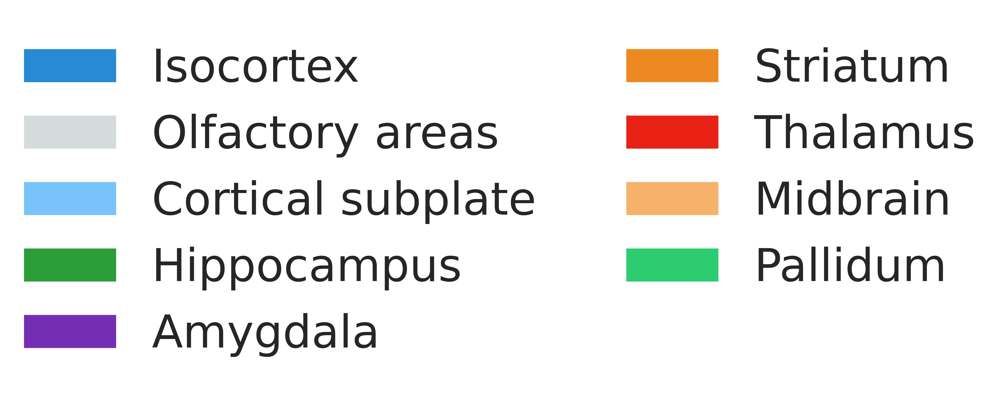

In [ ]:
region_colors2 = {'Isocortex': '#268ad5',
 'Olfactory areas': '#D5DBDB',
 'Cortical subplate': '#7ac3fa',
 'Hippocampus': '#2c9d39',
 'Amygdala': '#742eb5',
 'Striatum': '#ed8921',
 'Thalamus': '#e82315',
 'Midbrain': '#f6b26b',
 'Pallidum': '#2ECC71',}
# Create a figure for the legend
fig, ax = plt.subplots(dpi=360, figsize=(10, 6))

# Create patches for each region
patches = [mpatches.Patch(color=color, label=region) for region, color in region_colors2.items()]

# Add the legend to the plot and make it take up the whole figure
ax.legend(handles=patches, loc='center', ncol=2, fontsize=50, frameon=False, 
          bbox_to_anchor=(0.5, 0.5), bbox_transform=plt.gcf().transFigure)

# Remove axes for a cleaner look
ax.axis('off')

# Adjust layout to remove any padding
plt.subplots_adjust(left=0, right=1, top=1, bottom=0)

# Show the legend
plt.show()

/tmp/ipykernel_8641/1286905267.py:25: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  cbar = plt.colorbar(sm, orientation="vertical")


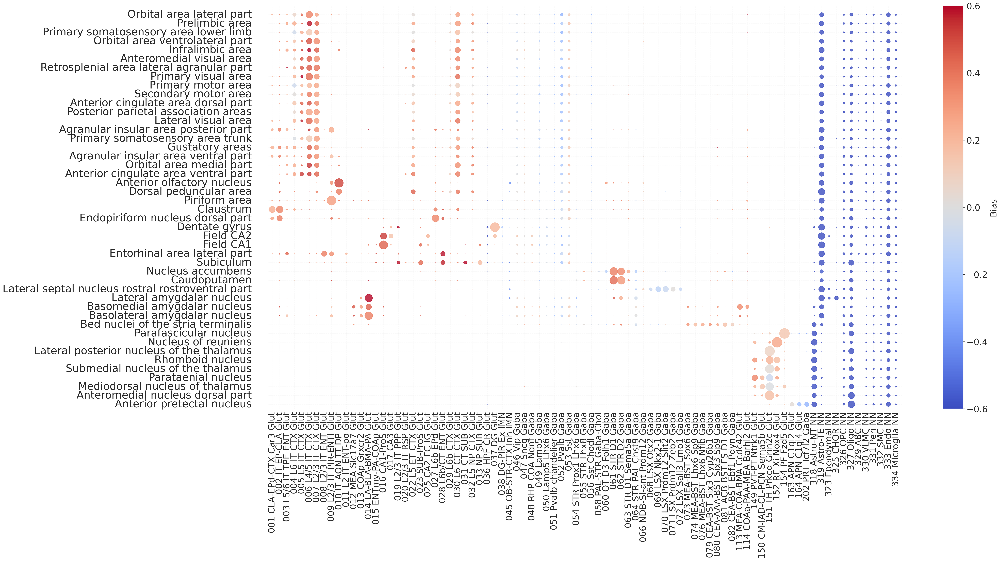

In [ ]:
fig, ax = plt.subplots(dpi=200, figsize=(35, 20))

scatter = ax.scatter(x, y, s=sizes, alpha=0.8, c=colors)

y_labels2 = ["{}    ".format(x) for x in y_labels]
ax.set_xticks(np.arange(len(x_labels)))
ax.set_xticklabels(x_labels, rotation=90, fontsize=25)
ax.set_yticks(np.arange(len(y_labels)))
ax.set_yticklabels(y_labels2, fontsize=30)

for tick in plt.gca().get_yticklabels():
    tick.set_verticalalignment('center')
    tick.set_multialignment('center')

ax.grid(True, linestyle='--', alpha=0.1)
ax.set_xlim(-0.5, len(x_labels))
ax.set_ylim(-0.5, len(y_labels))

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)
ax.spines['bottom'].set_visible(False)

# Add colorbar for bias values
cbar = plt.colorbar(sm, orientation="vertical")
cbar.set_label('Bias', fontsize=25)
cbar.ax.tick_params(labelsize=25)

plt.tight_layout()
plt.subplots_adjust(left=0.05, right=0.95, top=0.95, bottom=0.15)
plt.savefig("figs/ASD_top60_SubClass_CellCompBias.v2.pdf", bbox_inches='tight')

In [188]:
region_colors

{'Isocortex': '#268ad5',
 'Olfactory_areas': '#D5DBDB',
 'Cortical_subplate': '#7ac3fa',
 'Hippocampus': '#2c9d39',
 'Amygdalar': '#742eb5',
 'Striatum': '#ed8921',
 'Thalamus': '#e82315',
 'Hypothalamus': '#E6B0AA',
 'Midbrain': '#f6b26b',
 'Medulla': '#20124d',
 'Pallidum': '#2ECC71',
 'Pons': '#D2B4DE',
 'Cerebellum': '#ffd966'}

In [62]:
def ModifySTRName(STR_Names):
    res = []
    for Name in STR_Names:
        tokens = Name.split()
        len_token = len(tokens)
        if len(Name) > 10 and len_token > 1:
            len_token = len(tokens)
            #print(tokens, len_token)
            break_point = int(len_token/2)
            line1 = tokens[:break_point]
            line2 = tokens[break_point:]
            NewName = "{}\n{}".format(" ".join(line1), " ".join(line2))
        else:
            NewName = Name
        res.append(NewName)
    return res
y_labels2 = ModifySTRName(y_labels)

In [27]:
bias_df.head(2)

,Nucleus accumbens,Orbital area lateral part,Prelimbic area,Primary somatosensory area lower limb,Orbital area ventrolateral part,Parafascicular nucleus,Lateral amygdalar nucleus,Claustrum,Endopiriform nucleus dorsal part,Infralimbic area,...,Gustatory areas,Mediodorsal nucleus of thalamus,Agranular insular area ventral part,Piriform area,Orbital area medial part,Anterior cingulate area ventral part,Basolateral amygdalar nucleus,Anteromedial nucleus dorsal part,Entorhinal area lateral part,Subiculum
319 Astro-TE NN,-0.561415,-0.608609,-0.653834,-0.64166,-0.631749,-0.69943,-0.680141,-0.630584,-0.644215,-0.673906,...,-0.638353,-0.704297,-0.640841,-0.654064,-0.658504,-0.66601,-0.649927,-0.712421,-0.664894,-0.688144
061 STR D1 Gaba,0.370549,0.000000,0.000000,0.00000,0.000000,0.00000,0.471284,0.503046,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.397536,0.000000,0.00000,0.437541,0.000000,0.000000,0.000000


In [40]:
dat_ct_neur_comps = []
dat_ct_neur_bias = []
dat_ct_glia_comps = []
dat_ct_glia_bias = []
for i, str in enumerate(SubclassCellComp.columns.values):
    #print(str)
    list_ct = SubclassCellComp.index.values
    NN = [x for x in list_ct if x.endswith("NN")]
    NEU = [x for x in list_ct if not x.endswith("NEU")]
    str_ct_neur_comps = SubclassCellComp.loc[NEU, str]
    str_ct_neur_bias = bias_df.loc[NEU, str]
    str_ct_glia_comps = SubclassCellComp.loc[NN, str]
    str_ct_glia_bias = bias_df.loc[NN, str]
    
    dat_ct_neur_comps.extend(str_ct_neur_comps)
    dat_ct_neur_bias.extend(str_ct_neur_bias)
    dat_ct_glia_comps.extend(str_ct_glia_comps)
    dat_ct_glia_bias.extend(str_ct_glia_bias)



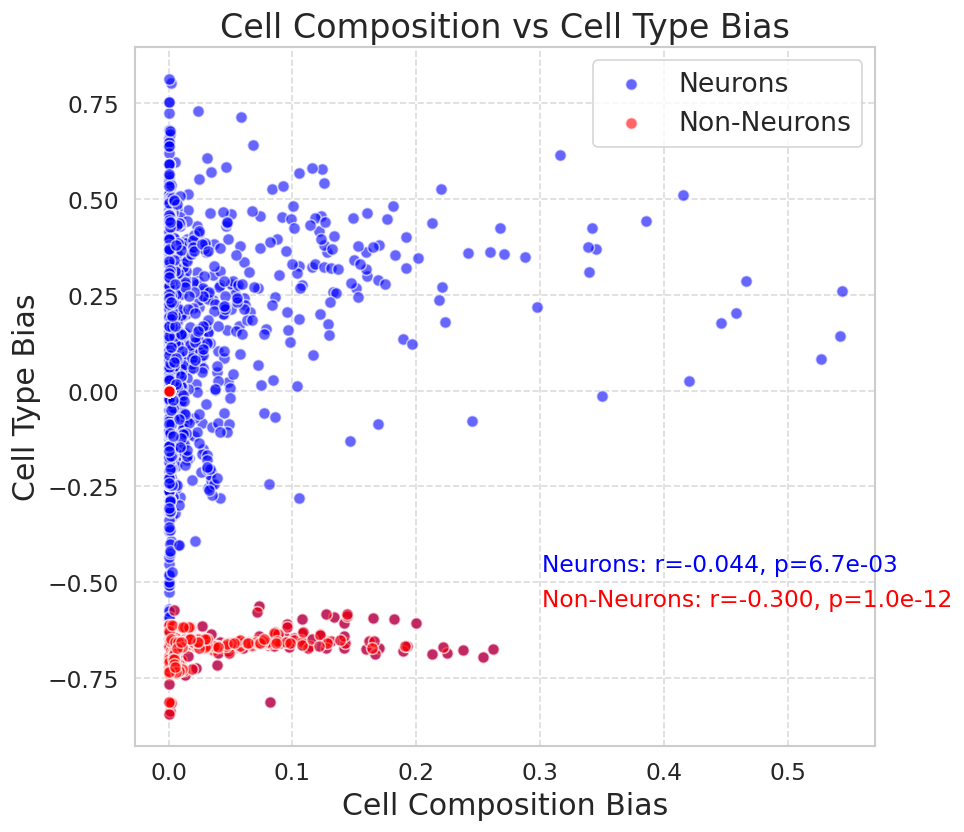

In [49]:
# Calculate Pearson correlation coefficients
r_neur, p_neur = pearsonr(dat_ct_neur_comps, dat_ct_neur_bias)
r_non_neur, p_non_neur = pearsonr(dat_ct_glia_comps, dat_ct_glia_bias)

# Create scatter plot
plt.figure(figsize=(8, 7), dpi=120)  # Increased figure size

# Plot neurons
plt.scatter(dat_ct_neur_comps, dat_ct_neur_bias, alpha=0.6, edgecolors='w', color='blue', label='Neurons', s=50)  # Increased marker size

# Plot glia
plt.scatter(dat_ct_glia_comps, dat_ct_glia_bias, alpha=0.6, edgecolors='w', color='red', label='Non-Neurons', s=50)  # Increased marker size

# Set labels and title
plt.xlabel("Cell Composition Bias", fontsize=18)  # Increased font size
plt.ylabel("Cell Type Bias", fontsize=18)  # Increased font size
plt.title("Cell Composition vs Cell Type Bias", fontsize=20)  # Increased font size

# Add correlation information to the plot
plt.text(0.55, 0.25, f"Neurons: r={r_neur:.3f}, p={p_neur:.1e}", transform=plt.gca().transAxes, fontsize=14, color='blue')  # Increased font size
plt.text(0.55, 0.20, f"Non-Neurons: r={r_non_neur:.3f}, p={p_non_neur:.1e}", transform=plt.gca().transAxes, fontsize=14, color='red')  # Increased font size

# Add legend
plt.legend(fontsize=16)  # Increased font size

# Add grid and improve layout
plt.grid(True, linestyle='--', alpha=0.7)
plt.tight_layout()

# Increase tick label font size
plt.xticks(fontsize=14)
plt.yticks(fontsize=14)

# Show plot
plt.show()

In [29]:
SubclassCellComp

,Nucleus accumbens,Orbital area lateral part,Prelimbic area,Primary somatosensory area lower limb,Orbital area ventrolateral part,Parafascicular nucleus,Lateral amygdalar nucleus,Claustrum,Endopiriform nucleus dorsal part,Infralimbic area,...,Gustatory areas,Mediodorsal nucleus of thalamus,Agranular insular area ventral part,Piriform area,Orbital area medial part,Anterior cingulate area ventral part,Basolateral amygdalar nucleus,Anteromedial nucleus dorsal part,Entorhinal area lateral part,Subiculum
001 CLA-EPd-CTX Car3 Glut,0.000000,0.007836,0.000000,0.000000,0.000000,0.000000,0.000112,0.218504,0.053240,0.000000,...,0.055036,0.000000,0.027860,0.005981,0.000000,0.000000,0.000000,0.000000,0.001837,0.000000
002 IT EP-CLA Glut,0.000000,0.003591,0.002412,0.000103,0.002731,0.000000,0.001236,0.259462,0.170228,0.005364,...,0.041718,0.000000,0.029456,0.009048,0.002494,0.001732,0.002494,0.000000,0.008037,0.000066
003 L5/6 IT TPE-ENT Glut,0.000000,0.004104,0.028559,0.000000,0.007859,0.000000,0.003707,0.004023,0.001751,0.041784,...,0.027783,0.000000,0.015313,0.002413,0.020298,0.006605,0.030530,0.000000,0.047418,0.001580
004 L6 IT CTX Glut,0.000000,0.072528,0.085732,0.077294,0.046753,0.000000,0.000000,0.024502,0.000000,0.035432,...,0.045775,0.000000,0.013399,0.000449,0.055560,0.059227,0.000227,0.000000,0.000230,0.000000
005 L5 IT CTX Glut,0.000000,0.022854,0.009812,0.055151,0.014719,0.000000,0.000000,0.001097,0.000000,0.015387,...,0.003352,0.000000,0.002339,0.000013,0.008773,0.083806,0.000000,0.000000,0.000184,0.000197
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
330 VLMC NN,0.002624,0.003265,0.014088,0.006766,0.005994,0.004769,0.004044,0.006400,0.003678,0.006635,...,0.011289,0.005696,0.021480,0.016620,0.020900,0.007435,0.002191,0.005394,0.022779,0.007042
331 Peri NN,0.008264,0.015951,0.010744,0.013019,0.014053,0.012221,0.011121,0.013897,0.015412,0.010870,...,0.014465,0.016570,0.014462,0.015453,0.011869,0.010972,0.015567,0.012812,0.016326,0.011649
332 SMC NN,0.002711,0.003172,0.007126,0.003485,0.005661,0.011624,0.001797,0.006765,0.004203,0.003247,...,0.004586,0.005696,0.010527,0.008432,0.004644,0.005089,0.003476,0.004046,0.004524,0.004870
333 Endo NN,0.041867,0.090159,0.074659,0.075448,0.078721,0.065872,0.047405,0.064180,0.072504,0.067617,...,0.073117,0.087407,0.094534,0.087042,0.076546,0.063919,0.073528,0.076871,0.097844,0.053113


# Test Connectivity

In [23]:
# For Sibling
ScoreMatDir="/home/jw3514/Work/ASD_Circuits/dat/allen-mouse-conn/ScoreingMat_jw_v3/"
IpsiInfoMat=pd.read_csv(ScoreMatDir + "InfoMat.Ipsi.csv", index_col=0)
IpsiInfoMatShort_v1=pd.read_csv(ScoreMatDir + "InfoMat.Ipsi.Short.3900.csv", index_col=0)
IpsiInfoMatLong_v1=pd.read_csv(ScoreMatDir + "InfoMat.Ipsi.Long.3900.csv", index_col=0)

In [19]:
def FixSubiculum_reverse(DF):
    Z = DF.loc["Subiculum"]
    DF.loc["Subiculum_dorsal_part", :] = Z
    DF.loc["Subiculum_ventral_part", :] = Z
    DF = DF.drop(["Subiculum"])
    DF = DF.sort_values("EFFECT", ascending=False)
    return DF

In [105]:
ASD_Bias_MERFISH_STR_Z2_CM = pd.read_csv("dat/Bias/STR/ASD.MERFISH_Allen.CM.ISHMatch.Z2.csv", index_col=0)
ASD_Bias_MERFISH_STR_Z2_VM = pd.read_csv("dat/Bias/STR/ASD.MERFISH_Allen.VM.ISHMatch.Z2.csv", index_col=0)

In [106]:
ASD_Bias_MERFISH_STR_Z2_CM = FixSubiculum_reverse(ASD_Bias_MERFISH_STR_Z2_CM)
ASD_Bias_MERFISH_STR_Z2_VM = FixSubiculum_reverse(ASD_Bias_MERFISH_STR_Z2_VM)

In [107]:
ASD_Bias_MERFISH_STR_Z2_VM.to_csv("dat/Bias/STR/ASD.MERFISH_Allen.VM.ISHMatch.Z2.splitSB.csv")

In [20]:
XX = pd.read_csv("dat/Bias/STR/ASD.MERFISH_Allen.NM.ISHMatch.Z2.csv", index_col=0)
XX = ASD_Bias_MERFISH_STR_Z2_VM = FixSubiculum_reverse(XX)
XX.to_csv("dat/Bias/STR/ASD.MERFISH_Allen.NM.ISHMatch.Z2.splitSB.csv")

In [462]:
#ASD_159_bias = pd.read_csv("../../ASD_Circuits/dat/Unionize_bias/ASD.159.pLI.z2.csv", index_col=0)

In [463]:
#ASD_159_bias.head(50)

In [149]:
STR_Ranks = ASD_Bias_MERFISH_STR_Z2_CM.index.values
#STR_Ranks = ASD_Bias.index.values
topNs = list(range(200, 5, -1))
SC_Agg_topN_score = []
SC_Agg_topN_scoreShort = []
SC_Agg_topN_scoreLong = []
for topN in topNs:
    top_strs = STR_Ranks[:topN]
    score = ScoreCircuit_SI_Joint(top_strs, IpsiInfoMat)
    scoreShort = ScoreCircuit_SI_Joint(top_strs, IpsiInfoMatShort_v1)
    scoreLong = ScoreCircuit_SI_Joint(top_strs, IpsiInfoMatLong_v1)
    SC_Agg_topN_score.append(score)
    SC_Agg_topN_scoreShort.append(scoreShort)
    SC_Agg_topN_scoreLong.append(scoreLong)
SC_Agg_topN_score = np.array(SC_Agg_topN_score)
SC_Agg_topN_scoreShort = np.array(SC_Agg_topN_scoreShort)
SC_Agg_topN_scoreLong = np.array(SC_Agg_topN_scoreLong)

In [34]:
topNs = np.arange(200, 5, -1)
DIR = "/home/jw3514/Work/ASD_Circuits/scripts/RankScores"
Cont_Distance = np.load("{}/RankScore.Ipsi.Cont.npy".format(DIR))
Cont_DistanceShort = np.load("{}/RankScore.Ipsi.Short.3900.Cont.npy".format(DIR))
Cont_DistanceLong = np.load("{}/RankScore.Ipsi.Long.3900.Cont.npy".format(DIR))

In [151]:
for n, obs, obs1, obs2 in list(zip(topNs, SC_Agg_topN_score, SC_Agg_topN_scoreShort, SC_Agg_topN_scoreLong)):
    if n < 60:
        Null = Cont_Distance[:, np.where(topNs==n)].flatten()
        z, p = GetPermutationP(Null, obs)
        
        Null = Cont_DistanceShort[:, np.where(topNs==n)].flatten()
        z1, p1 = GetPermutationP(Null, obs1)
        
        Null = Cont_DistanceLong[:, np.where(topNs==n)].flatten()
        z2, p2 = GetPermutationP(Null, obs2)
        print("%d %.3f %.4f %.4f %.4f"%(n, obs, p, p1, p2))

59 0.482 0.0218 0.0004 0.1388
58 0.481 0.0239 0.0007 0.1345
57 0.479 0.0278 0.0007 0.1574
56 0.481 0.0273 0.0003 0.1811
55 0.490 0.0226 0.0006 0.1673
54 0.497 0.0203 0.0006 0.1473
53 0.510 0.0161 0.0004 0.1313
52 0.508 0.0184 0.0006 0.1244
51 0.496 0.0265 0.0014 0.1245
50 0.497 0.0291 0.0016 0.1259
49 0.469 0.0582 0.0048 0.1895
48 0.476 0.0541 0.0049 0.1691
47 0.485 0.0460 0.0038 0.1574
46 0.486 0.0479 0.0044 0.1573
45 0.492 0.0443 0.0038 0.1486
44 0.510 0.0319 0.0036 0.1236
43 0.517 0.0289 0.0032 0.1157
42 0.524 0.0268 0.0028 0.1082
41 0.490 0.0579 0.0038 0.2017
40 0.504 0.0464 0.0032 0.1859
39 0.466 0.0990 0.0051 0.3718
38 0.462 0.1115 0.0076 0.3469
37 0.467 0.1055 0.0073 0.3526
36 0.482 0.0866 0.0073 0.3143
35 0.501 0.0664 0.0052 0.2847
34 0.488 0.0862 0.0073 0.3035
33 0.480 0.1036 0.0069 0.3165
32 0.460 0.1415 0.0196 0.2874
31 0.459 0.1476 0.0194 0.3264
30 0.471 0.1314 0.0147 0.3041
29 0.494 0.0964 0.0127 0.2680
28 0.510 0.0845 0.0130 0.2631
27 0.521 0.0749 0.0130 0.2376
26 0.505 0

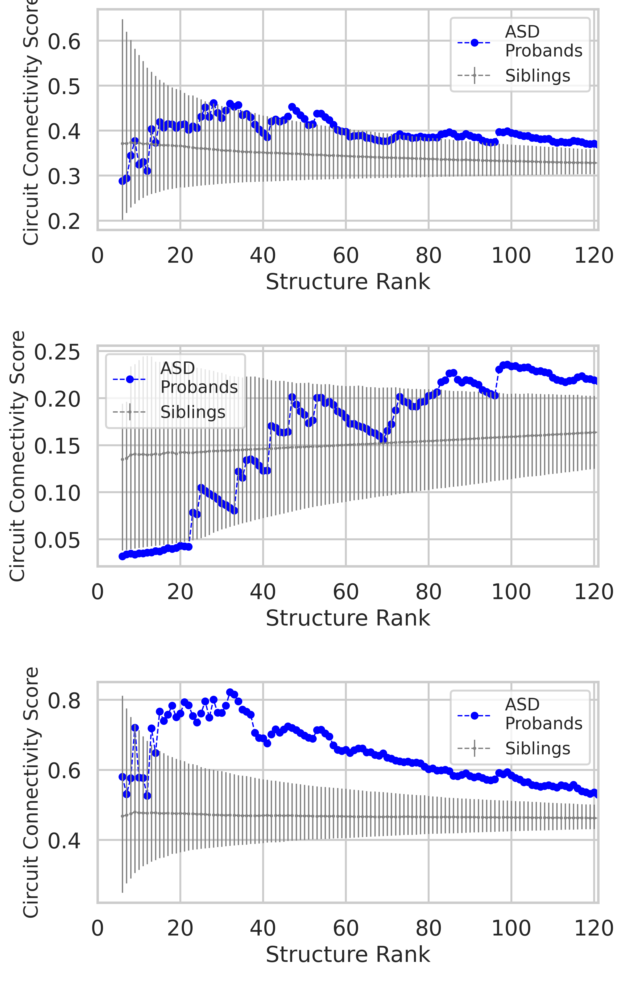

In [148]:
import matplotlib.backends.backend_pdf

fig, (ax1, ax2, ax3) = plt.subplots(3,1, dpi=480, figsize=(7,11))

BarLen = 34.1
#BarLen = 47.5

cont = np.median(Cont_Distance, axis=0)
ax1.plot(topNs, SC_Agg_topN_score, color="blue", marker="o", markersize=5, lw=1,
                     ls="dashed", label="ASD\nProbands")

lower = np.percentile(Cont_Distance, 50-BarLen, axis=0)
upper = np.percentile(Cont_Distance, 50+BarLen, axis=0)
ax1.errorbar(topNs, cont, color="grey", marker="o", markersize=1.5, lw=1,
            yerr=(cont - lower, upper - cont ), ls="dashed", label="Siblings")
ax1.set_xlabel("Structure Rank\n", fontsize=17)
ax1.set_ylabel("Circuit Connectivity Score", fontsize=15)
ax1.legend(fontsize=13)

cont = np.nanmean(Cont_DistanceLong, axis=0)
ax2.plot(topNs, SC_Agg_topN_scoreLong, color="blue", marker="o", markersize=5, lw=1,
                     ls="dashed", label="ASD\nProbands")

lower = np.nanpercentile(Cont_DistanceLong, 50-BarLen, axis=0)
upper = np.nanpercentile(Cont_DistanceLong, 50+BarLen, axis=0)
ax2.errorbar(topNs, cont, color="grey", marker="o", markersize=1.5, lw=1,
            yerr=(cont - lower, abs(upper - cont) ), ls="dashed", label="Siblings")
ax2.set_xlabel("Structure Rank\n", fontsize=17)
ax2.set_ylabel("Circuit Connectivity Score", fontsize=15)
ax2.legend(fontsize=13)

cont = np.median(Cont_DistanceShort, axis=0)
ax3.plot(topNs, SC_Agg_topN_scoreShort, color="blue", marker="o", markersize=5, lw=1,
                     ls="dashed", label="ASD\nProbands")

lower = np.percentile(Cont_DistanceShort, 50-BarLen, axis=0)
upper = np.percentile(Cont_DistanceShort, 50+BarLen, axis=0)
ax3.errorbar(topNs, cont, color="grey", marker="o", markersize=1.5, lw=1,
            yerr=(cont - lower, upper - cont ), ls="dashed", label="Siblings")
ax3.set_xlabel("Structure Rank\n", fontsize=17)
ax3.set_ylabel("Circuit Connectivity Score", fontsize=15)
ax3.legend(fontsize=13)

#fig.text(0.5, -0.03, 'Top Number of Structuress', ha='center')
#fig.text(-0.03, 0.5, 'SI Score', va='center', rotation='vertical')
ax1.set_xlim(0, 121)
ax2.set_xlim(0, 121)
ax3.set_xlim(0, 121)
plt.tight_layout()
#plt.legend(fontsize=15)
ax1.grid(True)
ax2.grid(True)
ax3.grid(True)
#plt.savefig("../figs/main/Fig2.BCD.pdf")
#plt.savefig("../figs/main/Fig2.BCD.png")

In [21]:
ASD_Bias_MERFISH_STR_Z2_NM = XX

In [25]:
STR_Ranks = ASD_Bias_MERFISH_STR_Z2_NM.index.values
#STR_Ranks = ASD_Bias.index.values
topNs = list(range(200, 5, -1))
SC_Agg_topN_score = []
SC_Agg_topN_scoreShort = []
SC_Agg_topN_scoreLong = []
for topN in topNs:
    top_strs = STR_Ranks[:topN]
    score = ScoreCircuit_SI_Joint(top_strs, IpsiInfoMat)
    scoreShort = ScoreCircuit_SI_Joint(top_strs, IpsiInfoMatShort_v1)
    scoreLong = ScoreCircuit_SI_Joint(top_strs, IpsiInfoMatLong_v1)
    SC_Agg_topN_score.append(score)
    SC_Agg_topN_scoreShort.append(scoreShort)
    SC_Agg_topN_scoreLong.append(scoreLong)
SC_Agg_topN_score = np.array(SC_Agg_topN_score)
SC_Agg_topN_scoreShort = np.array(SC_Agg_topN_scoreShort)
SC_Agg_topN_scoreLong = np.array(SC_Agg_topN_scoreLong)

In [35]:
Cont_Distance[:, np.where(topNs==50)].flatten()

array([0.32065836, 0.39842471, 0.39662864, ..., 0.33757585, 0.32400677,
       0.33839526])

In [36]:
for n, obs, obs1, obs2 in list(zip(topNs, SC_Agg_topN_score, SC_Agg_topN_scoreShort, SC_Agg_topN_scoreLong)):
    if n < 60:
        Null = Cont_Distance[:, np.where(topNs==n)].flatten()
        z, p = GetPermutationP(Null, obs)
        
        Null = Cont_DistanceShort[:, np.where(topNs==n)].flatten()
        z1, p1 = GetPermutationP(Null, obs1)
        
        Null = Cont_DistanceLong[:, np.where(topNs==n)].flatten()
        z2, p2 = GetPermutationP(Null, obs2)
        print("%d %.3f %.4f %.4f %.4f"%(n, obs, p, p1, p2))

59 0.633 0.0001 0.0001 0.0054
58 0.640 0.0001 0.0001 0.0056
57 0.653 0.0001 0.0001 0.0057
56 0.658 0.0001 0.0001 0.0072
55 0.643 0.0002 0.0001 0.0121
54 0.651 0.0001 0.0001 0.0105
53 0.637 0.0003 0.0001 0.0118
52 0.634 0.0006 0.0001 0.0109
51 0.640 0.0005 0.0001 0.0103
50 0.647 0.0005 0.0001 0.0087
49 0.615 0.0015 0.0001 0.0196
48 0.608 0.0019 0.0001 0.0288
47 0.613 0.0015 0.0001 0.0297
46 0.621 0.0018 0.0001 0.0299
45 0.606 0.0025 0.0001 0.0452
44 0.613 0.0024 0.0001 0.0469
43 0.629 0.0019 0.0001 0.0421
42 0.618 0.0033 0.0001 0.0389
41 0.625 0.0028 0.0001 0.0340
40 0.617 0.0035 0.0001 0.0322
39 0.590 0.0090 0.0001 0.0595
38 0.596 0.0088 0.0002 0.0523
37 0.540 0.0283 0.0007 0.0997
36 0.546 0.0281 0.0008 0.0939
35 0.565 0.0206 0.0004 0.0842
34 0.554 0.0276 0.0011 0.0865
33 0.553 0.0302 0.0019 0.0799
32 0.537 0.0439 0.0050 0.0728
31 0.555 0.0358 0.0024 0.0781
30 0.565 0.0331 0.0022 0.0878
29 0.564 0.0361 0.0041 0.0770
28 0.569 0.0369 0.0036 0.0708
27 0.553 0.0485 0.0080 0.0651
26 0.575 0

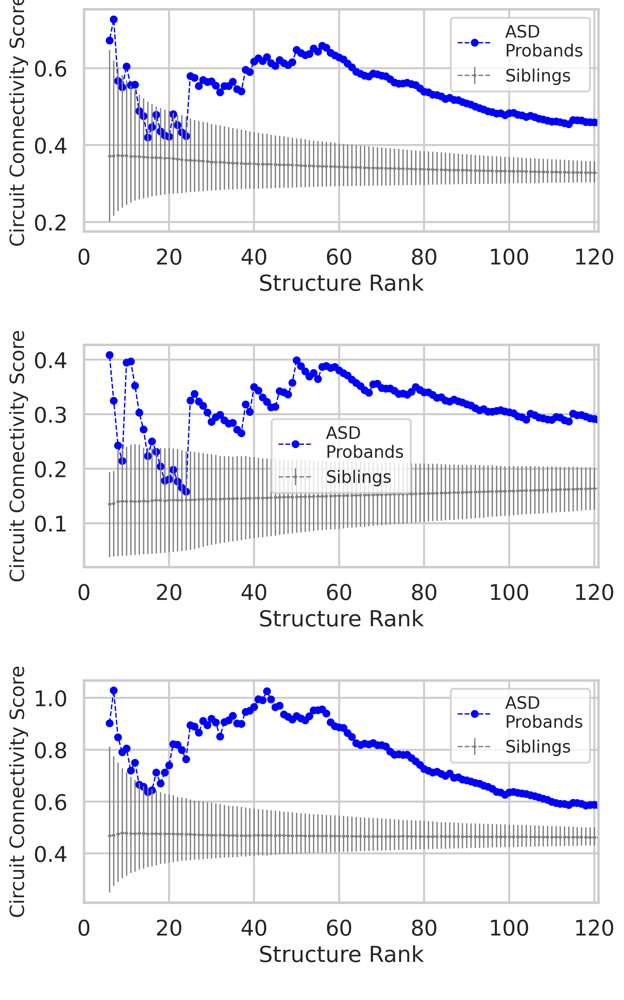

In [37]:
import matplotlib.backends.backend_pdf

fig, (ax1, ax2, ax3) = plt.subplots(3,1, dpi=480, figsize=(7,11))

BarLen = 34.1
#BarLen = 47.5

cont = np.median(Cont_Distance, axis=0)
ax1.plot(topNs, SC_Agg_topN_score, color="blue", marker="o", markersize=5, lw=1,
                     ls="dashed", label="ASD\nProbands")

lower = np.percentile(Cont_Distance, 50-BarLen, axis=0)
upper = np.percentile(Cont_Distance, 50+BarLen, axis=0)
ax1.errorbar(topNs, cont, color="grey", marker="o", markersize=1.5, lw=1,
            yerr=(cont - lower, upper - cont ), ls="dashed", label="Siblings")
ax1.set_xlabel("Structure Rank\n", fontsize=17)
ax1.set_ylabel("Circuit Connectivity Score", fontsize=15)
ax1.legend(fontsize=13)

cont = np.nanmean(Cont_DistanceLong, axis=0)
ax2.plot(topNs, SC_Agg_topN_scoreLong, color="blue", marker="o", markersize=5, lw=1,
                     ls="dashed", label="ASD\nProbands")

lower = np.nanpercentile(Cont_DistanceLong, 50-BarLen, axis=0)
upper = np.nanpercentile(Cont_DistanceLong, 50+BarLen, axis=0)
ax2.errorbar(topNs, cont, color="grey", marker="o", markersize=1.5, lw=1,
            yerr=(cont - lower, abs(upper - cont) ), ls="dashed", label="Siblings")
ax2.set_xlabel("Structure Rank\n", fontsize=17)
ax2.set_ylabel("Circuit Connectivity Score", fontsize=15)
ax2.legend(fontsize=13)

cont = np.median(Cont_DistanceShort, axis=0)
ax3.plot(topNs, SC_Agg_topN_scoreShort, color="blue", marker="o", markersize=5, lw=1,
                     ls="dashed", label="ASD\nProbands")

lower = np.percentile(Cont_DistanceShort, 50-BarLen, axis=0)
upper = np.percentile(Cont_DistanceShort, 50+BarLen, axis=0)
ax3.errorbar(topNs, cont, color="grey", marker="o", markersize=1.5, lw=1,
            yerr=(cont - lower, upper - cont ), ls="dashed", label="Siblings")
ax3.set_xlabel("Structure Rank\n", fontsize=17)
ax3.set_ylabel("Circuit Connectivity Score", fontsize=15)
ax3.legend(fontsize=13)

#fig.text(0.5, -0.03, 'Top Number of Structuress', ha='center')
#fig.text(-0.03, 0.5, 'SI Score', va='center', rotation='vertical')
ax1.set_xlim(0, 121)
ax2.set_xlim(0, 121)
ax3.set_xlim(0, 121)
plt.tight_layout()
#plt.legend(fontsize=15)
ax1.grid(True)
ax2.grid(True)
ax3.grid(True)
#plt.savefig("../figs/main/Fig2.BCD.pdf")
#plt.savefig("../figs/main/Fig2.BCD.png")

In [38]:
XX = pd.read_csv("/home/jw3514/Work/CellType_Psy/AllenBrainCellAtlas/dat/JonDat/MERFISH_Bias_NeuroOnly_JC.csv", index_col=0)
XX = ASD_Bias_MERFISH_STR_Z2_VM = FixSubiculum_reverse(XX)
XX.to_csv("/home/jw3514/Work/CellType_Psy/AllenBrainCellAtlas/dat/JonDat/MERFISH_Bias_NeuroOnly_JC.splitSB.csv")